# Plotting rumen temperature data

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

In [2]:
dfs = pd.read_csv("DataFrame.csv") # read csv files

In [3]:
dfs.head()

,new_col,Breed,Treatment,Date,Time,RumenT
0,2065,Charolais,Unshaded,22-Nov-12,12:31:05,30.56
1,2065,Charolais,Unshaded,22-Nov-12,12:39:48,30.56
2,2065,Charolais,Unshaded,22-Nov-12,12:48:50,30.56
3,2065,Charolais,Unshaded,22-Nov-12,12:57:51,30.56
4,2065,Charolais,Unshaded,22-Nov-12,13:06:45,30.56


In [4]:
dfs.rename(columns={"new_col": "Cattle_ID"}, inplace = True) # rename colum name and convert Date into datatime index
dfs["Date"] = pd.to_datetime(dfs["Date"])
dfs["Cattle_ID"] = 'CAAS' + dfs['Cattle_ID'].astype(str) # Add a string prefix to each value in a string column
dfs

,Cattle_ID,Breed,Treatment,Date,Time,RumenT
0,CAAS2065,Charolais,Unshaded,2012-11-22,12:31:05,30.56
1,CAAS2065,Charolais,Unshaded,2012-11-22,12:39:48,30.56
2,CAAS2065,Charolais,Unshaded,2012-11-22,12:48:50,30.56
3,CAAS2065,Charolais,Unshaded,2012-11-22,12:57:51,30.56
4,CAAS2065,Charolais,Unshaded,2012-11-22,13:06:45,30.56
...,...,...,...,...,...,...
522234,CAAS2105,Brahman,shaded,2013-04-14,12:09:24,39.00
522235,CAAS2105,Brahman,shaded,2013-04-14,12:19:28,39.00
522236,CAAS2105,Brahman,shaded,2013-04-14,12:27:19,39.22
522237,CAAS2105,Brahman,shaded,2013-04-14,12:38:15,39.22


In [5]:
dfs.nunique() # check the data features

Cattle_ID       36
Breed            3
Treatment        2
Date           144
Time         86182
RumenT          72
dtype: int64

In [6]:
dfs.info() # information about the DataFrame

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 522239 entries, 0 to 522238
Data columns (total 6 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Cattle_ID  522239 non-null  object        
 1   Breed      522239 non-null  object        
 2   Treatment  522239 non-null  object        
 3   Date       522239 non-null  datetime64[ns]
 4   Time       522239 non-null  object        
 5   RumenT     522239 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(4)
memory usage: 23.9+ MB


# Plotting whole time series

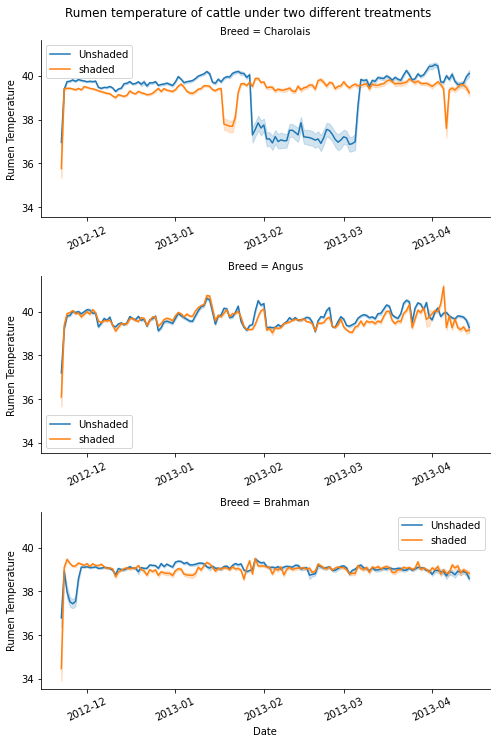

In [7]:
# Initialize a grid of plots with an Axes for each animal
grid = sns.FacetGrid(dfs, col="Breed", hue="Treatment", col_wrap=1,height=3.5, aspect= 2, sharex=False)
#grid = sns.FacetGrid(df, col="ID", hue="Treatment", col_wrap=1,size = 1.5,height=4, aspect= 4)
# Draw a horizontal line to show the starting point
#grid.map(plt.axhline, y=30, ls=":", c=".5")

# Draw a line plot to show the trajectory of rumen temperature across time
#grid.map(plt.plot, "Date", "RumenT", marker="o", ms=4)
grid.map(sns.lineplot, "Date", "RumenT")
fig = plt.gcf()
fig.suptitle("Rumen temperature of cattle under two different treatments")
grid.set_axis_labels("Date", "Rumen Temperature")
#grid.map(sns.histplot, "Date", "RumenT")
grid.set_xticklabels(rotation=25)
# Adjust the arrangement of the plots
grid.fig.tight_layout(w_pad=1)
for ax in grid.axes.ravel():
    ax.legend()
#grid.add_legend()
#show
plt.show()

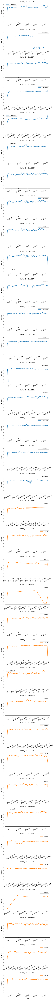

In [8]:
# Initialize a grid of plots with an Axes for each animal
grid = sns.FacetGrid(dfs, col="Cattle_ID", hue="Treatment", col_wrap=1,height=3, aspect= 2, sharex=False)
#grid = sns.FacetGrid(df, col="ID", hue="Treatment", col_wrap=1,size = 1.5,height=4, aspect= 4)
# Draw a horizontal line to show the starting point
#grid.map(plt.axhline, y=32, ls=":", c=".5")

# Draw a line plot to show the trajectory of capital across time
#grid.map(plt.plot, "Date", "RumenT", marker="o", ms=4)
grid.map(sns.lineplot, "Date", "RumenT")
#fig = plt.gcf()
#fig.suptitle(" Trajectory of rumen temperature across time")
#grid.map(sns.histplot, "Date", "RumenT")
grid.set_xticklabels(rotation=25)
# Adjust the arrangement of the plots
grid.fig.tight_layout(w_pad=1)
for ax in grid.axes.ravel():
    ax.legend()
#show
plt.show()

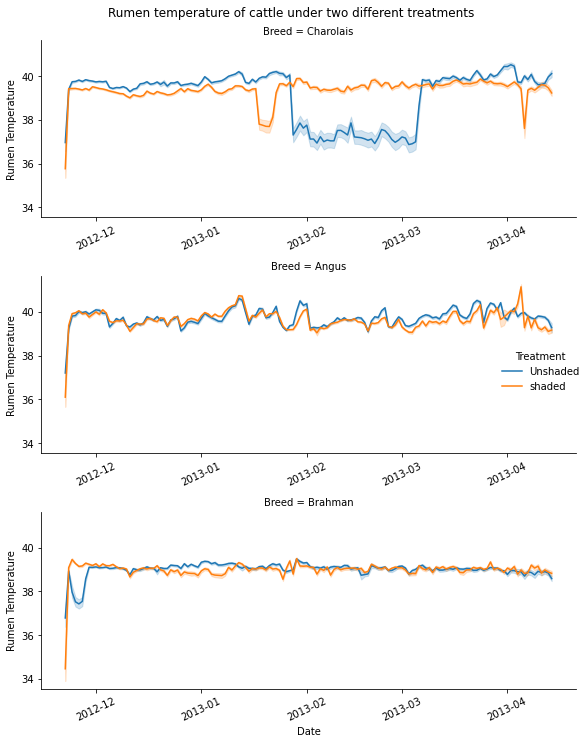

In [9]:
# Initialize a grid of plots with an Axes for each breed under two treatments
grid = sns.FacetGrid(dfs, col="Breed", hue="Treatment", col_wrap=1,height=3.5, aspect= 2, sharex=False)
#grid = sns.FacetGrid(df, col="ID", hue="Treatment", col_wrap=1,size = 1.5,height=4, aspect= 4)
# Draw a horizontal line to show the starting point
#grid.map(plt.axhline, y=30, ls=":", c=".5")

# Draw a line plot to show the trajectory of capital across time
#grid.map(plt.plot, "Date", "RumenT", marker="o", ms=4)
grid.map(sns.lineplot, "Date", "RumenT")
fig = plt.gcf()
fig.suptitle("Rumen temperature of cattle under two different treatments")
grid.set_axis_labels("Date", "Rumen Temperature")
grid.add_legend()
#grid.map(sns.histplot, "Date", "RumenT")
grid.set_xticklabels(rotation=25)
# Adjust the arrangement of the plots
grid.fig.tight_layout(w_pad=1)
#grid.add_legend()
#show
plt.show()

In [10]:
animal1 = dfs[dfs["Cattle_ID"] == "CAAS2065"] # Select particular animal from the dfs
animal1

,Cattle_ID,Breed,Treatment,Date,Time,RumenT
0,CAAS2065,Charolais,Unshaded,2012-11-22,12:31:05,30.56
1,CAAS2065,Charolais,Unshaded,2012-11-22,12:39:48,30.56
2,CAAS2065,Charolais,Unshaded,2012-11-22,12:48:50,30.56
3,CAAS2065,Charolais,Unshaded,2012-11-22,12:57:51,30.56
4,CAAS2065,Charolais,Unshaded,2012-11-22,13:06:45,30.56
...,...,...,...,...,...,...
18935,CAAS2065,Charolais,Unshaded,2013-04-14,12:00:12,41.22
18936,CAAS2065,Charolais,Unshaded,2013-04-14,12:08:36,41.22
18937,CAAS2065,Charolais,Unshaded,2013-04-14,12:17:53,41.22
18938,CAAS2065,Charolais,Unshaded,2013-04-14,12:27:09,41.22


In [11]:
animal1['Time'] = pd.to_timedelta(animal1['Time']) # convert time to timedelta 
animal1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18940 entries, 0 to 18939
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype          
---  ------     --------------  -----          
 0   Cattle_ID  18940 non-null  object         
 1   Breed      18940 non-null  object         
 2   Treatment  18940 non-null  object         
 3   Date       18940 non-null  datetime64[ns] 
 4   Time       18940 non-null  timedelta64[ns]
 5   RumenT     18940 non-null  float64        
dtypes: datetime64[ns](1), float64(1), object(3), timedelta64[ns](1)
memory usage: 1.0+ MB


C:\Users\mrah7296\AppData\Local\Temp\ipykernel_54784\198310985.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  animal1['Time'] = pd.to_timedelta(animal1['Time']) # convert time to timedelta


In [12]:
animal1['DateTime'] = pd.to_datetime(animal1.pop('Date')) + pd.to_timedelta(animal1.pop('Time'))

C:\Users\mrah7296\AppData\Local\Temp\ipykernel_54784\3908982437.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  animal1['DateTime'] = pd.to_datetime(animal1.pop('Date')) + pd.to_timedelta(animal1.pop('Time'))


In [13]:
animal1.head(10)

,Cattle_ID,Breed,Treatment,RumenT,DateTime
0,CAAS2065,Charolais,Unshaded,30.56,2012-11-22 12:31:05
1,CAAS2065,Charolais,Unshaded,30.56,2012-11-22 12:39:48
2,CAAS2065,Charolais,Unshaded,30.56,2012-11-22 12:48:50
3,CAAS2065,Charolais,Unshaded,30.56,2012-11-22 12:57:51
4,CAAS2065,Charolais,Unshaded,30.56,2012-11-22 13:06:45
5,CAAS2065,Charolais,Unshaded,30.56,2012-11-22 13:15:40
6,CAAS2065,Charolais,Unshaded,30.56,2012-11-22 13:24:34
7,CAAS2065,Charolais,Unshaded,30.56,2012-11-22 13:33:33
8,CAAS2065,Charolais,Unshaded,30.56,2012-11-22 13:42:32
9,CAAS2065,Charolais,Unshaded,30.56,2012-11-22 13:51:30


In [48]:
# Using plotly.express
import plotly.express as px


fig = px.line(animal1, x='DateTime', y="RumenT")
fig.update_layout(title="Rumen temperature of UNSCH2065 over time ")
fig.show()

In [49]:
import plotly.express as px
import pandas as pd

#df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/finance-charts-apple.csv')

fig = px.line(animal1, x='DateTime', y='RumenT', title='Rumen temperature of UNSCH2065 in a single day')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1d", step="day", stepmode="backward"),
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()


In [50]:
fig = px.line(animal1, x='DateTime', y='RumenT', title='Rumen temperature of UNSCH2065 in a single day')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1d", step="day", stepmode="todate"),
            dict(count=1, label="1m", step="month", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="todate"),
            dict(count=1, label="Custom", step="year", stepmode="todate")
        ])
    )
)

fig.show()


In [51]:
fig = px.line(animal1, x='DateTime', y='RumenT', title='Rumen temperature of UNSCH2065 in a single day')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1d", step="day", stepmode="todate"),
            dict(count=1, label="1m", step="month", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="todate"),
            dict(step="all")
        ])
    )
)

fig.show()

In [52]:
fig = px.line(animal1, x='DateTime', y='RumenT', title='Rumen temperature of UNSCH2065 in a time period')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1d", step="day", stepmode="todate"),
            dict(count=1, label="1m", step="month", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="todate"),
            dict(step="all")
        ])
    )
)

fig.show()

In [19]:
# Using graph_objects
import plotly.graph_objects as go
fig = go.Figure([go.Scatter(x=animal1['DateTime'], y=animal1['RumenT'])])
fig.update_layout(yaxis=dict(range=[32.0,44.0], dtick=1))
fig.update_xaxes(title_text='Date/Time')
fig.update_yaxes(title_text='Rumen Temperature (°C)')
fig.show()

In [20]:
animal2 = dfs[dfs["Cattle_ID"] == "CAAS2089"]
animal2

,Cattle_ID,Breed,Treatment,Date,Time,RumenT
319737,CAAS2089,Charolais,shaded,2012-11-22,12:45:37,30.56
319738,CAAS2089,Charolais,shaded,2012-11-22,12:54:21,30.56
319739,CAAS2089,Charolais,shaded,2012-11-22,13:03:11,30.56
319740,CAAS2089,Charolais,shaded,2012-11-22,13:12:02,30.56
319741,CAAS2089,Charolais,shaded,2012-11-22,13:20:52,30.56
...,...,...,...,...,...,...
336890,CAAS2089,Charolais,shaded,2013-04-14,11:59:12,39.72
336891,CAAS2089,Charolais,shaded,2013-04-14,12:10:32,39.72
336892,CAAS2089,Charolais,shaded,2013-04-14,12:21:53,40.00
336893,CAAS2089,Charolais,shaded,2013-04-14,12:33:14,40.00


In [21]:
animal2['Time'] = pd.to_timedelta(animal2['Time'])
animal2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17158 entries, 319737 to 336894
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype          
---  ------     --------------  -----          
 0   Cattle_ID  17158 non-null  object         
 1   Breed      17158 non-null  object         
 2   Treatment  17158 non-null  object         
 3   Date       17158 non-null  datetime64[ns] 
 4   Time       17158 non-null  timedelta64[ns]
 5   RumenT     17158 non-null  float64        
dtypes: datetime64[ns](1), float64(1), object(3), timedelta64[ns](1)
memory usage: 938.3+ KB


C:\Users\mrah7296\AppData\Local\Temp\ipykernel_54784\1993978910.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [22]:
animal2['DateTime'] = pd.to_datetime(animal2.pop('Date')) + pd.to_timedelta(animal2.pop('Time'))

C:\Users\mrah7296\AppData\Local\Temp\ipykernel_54784\857281677.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [23]:
animal2.head(10)

,Cattle_ID,Breed,Treatment,RumenT,DateTime
319737,CAAS2089,Charolais,shaded,30.56,2012-11-22 12:45:37
319738,CAAS2089,Charolais,shaded,30.56,2012-11-22 12:54:21
319739,CAAS2089,Charolais,shaded,30.56,2012-11-22 13:03:11
319740,CAAS2089,Charolais,shaded,30.56,2012-11-22 13:12:02
319741,CAAS2089,Charolais,shaded,30.56,2012-11-22 13:20:52
319742,CAAS2089,Charolais,shaded,30.56,2012-11-22 13:30:14
319743,CAAS2089,Charolais,shaded,30.56,2012-11-22 13:39:03
319744,CAAS2089,Charolais,shaded,30.56,2012-11-22 13:47:53
319745,CAAS2089,Charolais,shaded,30.56,2012-11-22 13:56:42
319746,CAAS2089,Charolais,shaded,30.56,2012-11-22 14:05:31


In [53]:
fig = px.line(animal2, x='DateTime', y="RumenT")
fig.update_layout(title="Rumen temperature of SHCH2089 over time ")
fig.show()

In [54]:
fig = px.line(animal2, x='DateTime', y='RumenT', title='Rumen temperature of SHCH2089 in a day')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1d", step="day", stepmode="backward"),
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [55]:
fig = px.line(animal2, x='DateTime', y='RumenT', title='Rumen temperature of SHCH2089 in a period')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1d", step="day", stepmode="backward"),
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [27]:
animal3 = dfs[dfs["Cattle_ID"] == "CAAS2073"]
animal3

,Cattle_ID,Breed,Treatment,Date,Time,RumenT
142104,CAAS2073,Angus,Unshaded,2012-11-22,13:11:27,30.56
142105,CAAS2073,Angus,Unshaded,2012-11-22,13:20:28,30.56
142106,CAAS2073,Angus,Unshaded,2012-11-22,13:29:19,30.56
142107,CAAS2073,Angus,Unshaded,2012-11-22,13:38:17,30.56
142108,CAAS2073,Angus,Unshaded,2012-11-22,13:47:15,30.56
...,...,...,...,...,...,...
162860,CAAS2073,Angus,Unshaded,2013-04-14,6:16:51,44.72
162861,CAAS2073,Angus,Unshaded,2013-04-14,6:28:57,30.56
162862,CAAS2073,Angus,Unshaded,2013-04-14,6:41:02,44.72
162863,CAAS2073,Angus,Unshaded,2013-04-14,6:53:08,44.72


In [28]:
animal3['Time'] = pd.to_timedelta(animal3['Time'])
animal3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20761 entries, 142104 to 162864
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype          
---  ------     --------------  -----          
 0   Cattle_ID  20761 non-null  object         
 1   Breed      20761 non-null  object         
 2   Treatment  20761 non-null  object         
 3   Date       20761 non-null  datetime64[ns] 
 4   Time       20761 non-null  timedelta64[ns]
 5   RumenT     20761 non-null  float64        
dtypes: datetime64[ns](1), float64(1), object(3), timedelta64[ns](1)
memory usage: 1.1+ MB


C:\Users\mrah7296\AppData\Local\Temp\ipykernel_54784\3615235266.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [29]:
animal3.head(10)

,Cattle_ID,Breed,Treatment,Date,Time,RumenT
142104,CAAS2073,Angus,Unshaded,2012-11-22,0 days 13:11:27,30.56
142105,CAAS2073,Angus,Unshaded,2012-11-22,0 days 13:20:28,30.56
142106,CAAS2073,Angus,Unshaded,2012-11-22,0 days 13:29:19,30.56
142107,CAAS2073,Angus,Unshaded,2012-11-22,0 days 13:38:17,30.56
142108,CAAS2073,Angus,Unshaded,2012-11-22,0 days 13:47:15,30.56
142109,CAAS2073,Angus,Unshaded,2012-11-22,0 days 13:56:12,30.56
142110,CAAS2073,Angus,Unshaded,2012-11-22,0 days 14:05:10,30.56
142111,CAAS2073,Angus,Unshaded,2012-11-22,0 days 14:14:05,30.56
142112,CAAS2073,Angus,Unshaded,2012-11-22,0 days 14:22:56,30.56
142113,CAAS2073,Angus,Unshaded,2012-11-22,0 days 14:31:53,30.56


In [30]:
animal3['DateTime'] = pd.to_datetime(animal3.pop('Date')) + pd.to_timedelta(animal3.pop('Time'))


C:\Users\mrah7296\AppData\Local\Temp\ipykernel_54784\2601988821.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [31]:
animal3.head()

,Cattle_ID,Breed,Treatment,RumenT,DateTime
142104,CAAS2073,Angus,Unshaded,30.56,2012-11-22 13:11:27
142105,CAAS2073,Angus,Unshaded,30.56,2012-11-22 13:20:28
142106,CAAS2073,Angus,Unshaded,30.56,2012-11-22 13:29:19
142107,CAAS2073,Angus,Unshaded,30.56,2012-11-22 13:38:17
142108,CAAS2073,Angus,Unshaded,30.56,2012-11-22 13:47:15


In [56]:
fig = px.line(animal3, x='DateTime', y="RumenT")
fig.update_layout(title="Rumen temperature of UNSAN2073 over time ")
fig.show()

In [57]:
fig = px.line(animal3, x='DateTime', y='RumenT', title='Rumen temperature of UNSAN2073 in a day')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1d", step="day", stepmode="backward"),
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [58]:
fig = px.line(animal3, x='DateTime', y='RumenT', title='Rumen temperature of UNSAN2073 in a period')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1d", step="day", stepmode="backward"),
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [35]:
animal4 = dfs[dfs["Cattle_ID"] == "CAAS2086"]
animal4

,Cattle_ID,Breed,Treatment,Date,Time,RumenT
421642,CAAS2086,Angus,shaded,2012-11-22,12:35:21,30.56
421643,CAAS2086,Angus,shaded,2012-11-22,12:44:35,30.56
421644,CAAS2086,Angus,shaded,2012-11-22,12:53:25,30.56
421645,CAAS2086,Angus,shaded,2012-11-22,13:02:30,30.56
421646,CAAS2086,Angus,shaded,2012-11-22,13:11:22,30.56
...,...,...,...,...,...,...
441370,CAAS2086,Angus,shaded,2013-04-14,12:13:36,39.22
441371,CAAS2086,Angus,shaded,2013-04-14,12:22:51,39.22
441372,CAAS2086,Angus,shaded,2013-04-14,12:32:18,39.50
441373,CAAS2086,Angus,shaded,2013-04-14,12:41:44,39.72


In [36]:
animal4['Time'] = pd.to_timedelta(animal4['Time'])
animal4['DateTime'] = pd.to_datetime(animal4.pop('Date')) + pd.to_timedelta(animal4.pop('Time'))
animal4.head()

C:\Users\mrah7296\AppData\Local\Temp\ipykernel_54784\3214436622.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\mrah7296\AppData\Local\Temp\ipykernel_54784\3214436622.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Cattle_ID,Breed,Treatment,RumenT,DateTime
421642,CAAS2086,Angus,shaded,30.56,2012-11-22 12:35:21
421643,CAAS2086,Angus,shaded,30.56,2012-11-22 12:44:35
421644,CAAS2086,Angus,shaded,30.56,2012-11-22 12:53:25
421645,CAAS2086,Angus,shaded,30.56,2012-11-22 13:02:30
421646,CAAS2086,Angus,shaded,30.56,2012-11-22 13:11:22


In [59]:
fig = px.line(animal4, x='DateTime', y="RumenT")
fig.update_layout(title="Rumen temperature of SHAN2086 over time ")
fig.show()

In [60]:
fig = px.line(animal4, x='DateTime', y='RumenT', title='Rumen temperature of SHAN2086 in a day')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1d", step="day", stepmode="backward"),
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [61]:
fig = px.line(animal4, x='DateTime', y='RumenT', title='Rumen temperature of SHAN2086 in period')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1d", step="day", stepmode="backward"),
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()